In [1]:
import base64
import imageio
import IPython
import matplotlib.pyplot as plt
import os
import reverb
import tempfile
import PIL.Image

import tensorflow as tf

from tf_agents.agents.ddpg import critic_network
from tf_agents.agents.sac import sac_agent
from tf_agents.agents.sac import tanh_normal_projection_network
from tf_agents.environments import suite_gym
#from tf_agents.environments import suite_pybullet
from tf_agents.metrics import py_metrics
from tf_agents.networks import actor_distribution_network
from tf_agents.policies import greedy_policy
from tf_agents.policies import py_tf_eager_policy
from tf_agents.policies import random_py_policy
from tf_agents.replay_buffers import reverb_replay_buffer
from tf_agents.replay_buffers import reverb_utils
from tf_agents.train import actor
from tf_agents.train import learner
from tf_agents.train import triggers
from tf_agents.train.utils import spec_utils
from tf_agents.train.utils import strategy_utils
from tf_agents.train.utils import train_utils

tempdir = tempfile.gettempdir()

ModuleNotFoundError: No module named 'reverb'

In [2]:
env_name = "Humanoid-v3" # @param {type:"string"}

# Use "num_iterations = 1e6" for better results (2 hrs)
# 1e5 is just so this doesn't take too long (1 hr)
num_iterations = 100000 # @param {type:"integer"}

initial_collect_steps = 10000 # @param {type:"integer"}
collect_steps_per_iteration = 1 # @param {type:"integer"}
replay_buffer_capacity = 10000 # @param {type:"integer"}

batch_size = 256 # @param {type:"integer"}

critic_learning_rate = 3e-4 # @param {type:"number"}
actor_learning_rate = 3e-4 # @param {type:"number"}
alpha_learning_rate = 3e-4 # @param {type:"number"}
target_update_tau = 0.005 # @param {type:"number"}
target_update_period = 1 # @param {type:"number"}
gamma = 0.99 # @param {type:"number"}
reward_scale_factor = 1.0 # @param {type:"number"}

actor_fc_layer_params = (256, 256)
critic_joint_fc_layer_params = (256, 256)

log_interval = 5000 # @param {type:"integer"}
save_interval = 50000
num_eval_episodes = 20 # @param {type:"integer"}
eval_interval = 10000 # @param {type:"integer"}

policy_save_interval = 5000 # @param {type:"integer"}

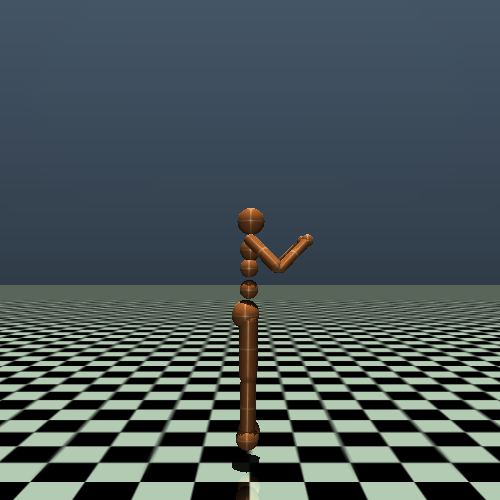

In [3]:
env = suite_gym.load(env_name)
#env = ActionDiscretizeWrapper(env, num_actions=5)
#tf_env = tf_py_environment.TFPyEnvironment(env)
env.reset()
PIL.Image.fromarray(env.render())

In [4]:
collect_env = suite_gym.load(env_name)
eval_env = suite_gym.load(env_name)

In [5]:
#Se débrouiller pour entrpainer avec le GPU
use_gpu = True #@param {type:"boolean"}
strategy = strategy_utils.get_strategy(tpu=False, use_gpu=use_gpu)

2022-09-28 13:56:32.763779: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /opt/conda/envs/railrl/lib/python3.7/site-packages/cv2/../../lib64:/mujoco/.mujoco/mujoco210/bin:/mujoco/.mujoco/mujoco200_linux/bin:/mujoco/.mujoco/mujoco200/bin:/mujoco/.mujoco/mjpro150/bin:/usr/local/nvidia/lib64:/usr/lib/x86_64-linux-gnu:/usr/lib/i386-linux-gnu:/usr/local/nvidia/lib:/usr/local/nvidia/lib64:/usr/local/nvidia/lib:/usr/local/nvidia/lib64:/root/.mujoco/mujoco210/bin
2022-09-28 13:56:32.764119: W tensorflow/stream_executor/cuda/cuda_driver.cc:263] failed call to cuInit: UNKNOWN ERROR (303)
2022-09-28 13:56:32.764146: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (d61e2a5e4935): /proc/driver/nvidia/version does not exist
2022-09-28 13:56:32.766324: I tensorflow/core/pl

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:CPU:0',)


INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:CPU:0',)


In [6]:
#Agents

observation_spec, action_spec, time_step_spec = (
      spec_utils.get_tensor_specs(collect_env))

with strategy.scope():
    critic_net = critic_network.CriticNetwork(
        (observation_spec, action_spec),
        observation_fc_layer_params=None,
        action_fc_layer_params=None,
        joint_fc_layer_params=critic_joint_fc_layer_params,
        kernel_initializer='glorot_uniform',
        last_kernel_initializer='glorot_uniform')

with strategy.scope():
    actor_net = actor_distribution_network.ActorDistributionNetwork(
        observation_spec,
        action_spec,
        fc_layer_params=actor_fc_layer_params,
        continuous_projection_net=(
            tanh_normal_projection_network.TanhNormalProjectionNetwork))


with strategy.scope():
    train_step = train_utils.create_train_step()

    tf_agent = sac_agent.SacAgent(
        time_step_spec,
        action_spec,
        actor_network=actor_net,
        critic_network=critic_net,
        actor_optimizer=tf.keras.optimizers.Adam(
            learning_rate=actor_learning_rate),
        critic_optimizer=tf.keras.optimizers.Adam(
            learning_rate=critic_learning_rate),
        alpha_optimizer=tf.keras.optimizers.Adam(
            learning_rate=alpha_learning_rate),
        target_update_tau=target_update_tau,
        target_update_period=target_update_period,
        td_errors_loss_fn=tf.math.squared_difference,
        gamma=gamma,
        reward_scale_factor=reward_scale_factor,
        train_step_counter=train_step)

    tf_agent.initialize()

In [7]:
#Tampon
rate_limiter=reverb.rate_limiters.SampleToInsertRatio(samples_per_insert=3.0, min_size_to_sample=3, error_buffer=3.0)
table_name = 'uniform_table'
table = reverb.Table(
    table_name,
    max_size=replay_buffer_capacity,
    sampler=reverb.selectors.Uniform(),
    remover=reverb.selectors.Fifo(),
    rate_limiter=reverb.rate_limiters.MinSize(1))

reverb_server = reverb.Server([table])
reverb_replay = reverb_replay_buffer.ReverbReplayBuffer(
    tf_agent.collect_data_spec,
    sequence_length=2,
    table_name=table_name,
    local_server=reverb_server)



[reverb/cc/platform/tfrecord_checkpointer.cc:162]  Initializing TFRecordCheckpointer in /tmp/tmprit2s49w.
[reverb/cc/platform/tfrecord_checkpointer.cc:567] Loading latest checkpoint from /tmp/tmprit2s49w
[reverb/cc/platform/default/server.cc:71] Started replay server on port 33883


In [8]:
#Dataset
dataset = reverb_replay.as_dataset(
      sample_batch_size=batch_size, num_steps=2).prefetch(50)
experience_dataset_fn = lambda: dataset

In [9]:
#Stratégies
tf_eval_policy = tf_agent.policy
eval_policy = py_tf_eager_policy.PyTFEagerPolicy(
    tf_eval_policy, use_tf_function=True)
tf_collect_policy = tf_agent.collect_policy
collect_policy = py_tf_eager_policy.PyTFEagerPolicy(
    tf_collect_policy, use_tf_function=True)

random_policy = random_py_policy.RandomPyPolicy(
    collect_env.time_step_spec(), collect_env.action_spec())

In [10]:
#Acteurs
rb_observer = reverb_utils.ReverbAddTrajectoryObserver(
    reverb_replay.py_client,
    table_name,
    sequence_length=2,
    stride_length=1)

initial_collect_actor = actor.Actor(
    collect_env,
    random_policy,
    train_step,
    steps_per_run=initial_collect_steps,
    observers=[rb_observer])
initial_collect_actor.run()



In [11]:
#Actor Collect and Form 
env_step_metric = py_metrics.EnvironmentSteps()
collect_actor = actor.Actor(
    collect_env,
    collect_policy,
    train_step,
    steps_per_run=1,
    metrics=actor.collect_metrics(10),
    summary_dir=os.path.join(tempdir, learner.TRAIN_DIR),
    observers=[rb_observer, env_step_metric])

eval_actor = actor.Actor(
    eval_env,
    eval_policy,
    train_step,
    episodes_per_run=num_eval_episodes,
    metrics=actor.eval_metrics(num_eval_episodes),
    summary_dir=os.path.join(tempdir, 'eval'),
    )

In [41]:
py_metrics.EnvironmentSteps().tf_summaries

<bound method PyMetric.tf_summaries of <tf_agents.metrics.py_metrics.EnvironmentSteps object at 0x7f6590a69a50>>

In [12]:
#Apprenants
saved_model_dir = os.path.join(tempdir, learner.POLICY_SAVED_MODEL_DIR)

# Triggers to save the agent's policy checkpoints.
learning_triggers = [
    triggers.PolicySavedModelTrigger(
        saved_model_dir,
        tf_agent,
        train_step,
        interval=policy_save_interval),
    triggers.StepPerSecondLogTrigger(train_step, interval=1000),
]

agent_learner = learner.Learner(
  tempdir,
  train_step,
  tf_agent,
  experience_dataset_fn,
  triggers=learning_triggers,
  strategy=strategy)

Instructions for updating:
`scale_identity_multiplier` is deprecated; please combine it into `scale_diag` directly instead.


Instructions for updating:
`scale_identity_multiplier` is deprecated; please combine it into `scale_diag` directly instead.
2022-09-28 14:00:38.658753: W tensorflow/core/framework/dataset.cc:769] Input of GeneratorDatasetOp::Dataset will not be optimized because the dataset does not implement the AsGraphDefInternal() method needed to apply optimizations.


In [13]:
#Metrics and eval
def get_eval_metrics():
    eval_actor.run()
    results = {}
    for metric in eval_actor.metrics:
        results[metric.name] = metric.result()
    return results

def log_eval_metrics(step, metrics):
    eval_results = (', ').join(
        '{} = {:.6f}'.format(name, result) for name, result in metrics.items())
    print('step = {0}: {1}'.format(step, eval_results))
    
metrics = get_eval_metrics()
log_eval_metrics(0, metrics)

step = 0: AverageReturn = 82.846893, AverageEpisodeLength = 17.799999


In [35]:
loss_info

LossInfo(loss=<tf.Tensor: shape=(), dtype=float32, numpy=-116.71699>, extra=SacLossInfo(critic_loss=<tf.Tensor: shape=(), dtype=float32, numpy=6.1056595>, actor_loss=<tf.Tensor: shape=(), dtype=float32, numpy=-122.88652>, alpha_loss=<tf.Tensor: shape=(), dtype=float32, numpy=0.063871115>))

In [ ]:
#Video
def embed_mp4(filename):
    """Embeds an mp4 file in the notebook."""
    video = open(filename,'rb').read()
    b64 = base64.b64encode(video)
    tag = '''
    <video width="640" height="480" controls>
    <source src="data:video/mp4;base64,{0}" type="video/mp4">
    Your browser does not support the video tag.
    </video>'''.format(b64.decode())

    return IPython.display.HTML(tag)

In [ ]:
try:
    %%time
except:
    pass

# Reset the train step
tf_agent.train_step_counter.assign(0)

# Evaluate the agent's policy once before training.
avg_return = get_eval_metrics()["AverageReturn"]
returns = [avg_return]

for i in range(num_iterations):
    # Training.
    collect_actor.run()
    loss_info = agent_learner.run(iterations=1)

    # Evaluating.
    step = agent_learner.train_step_numpy

    if step % eval_interval == 0:
        metrics = get_eval_metrics()
        log_eval_metrics(step, metrics)
        returns.append(metrics["AverageReturn"])

    if step % log_interval == 0:
        print('step = {0}: loss = {1}'.format(step, loss_info.loss.numpy()))
    
    if step % save_interval ==0 :
        train_checkpointer.save(global_step)
        checkpoint_zip_filename = create_zip_file(checkpoint_dir, os.path.join('.', 'exported_cp_humanoid'))
        steps = range(0, i + 1, eval_interval)
        plt.plot(steps, returns)
        plt.ylabel('Average Return')
        plt.xlabel('Step')
        plt.ylim()
        plt.savefig('result.png')
        
        num_episodes = num_iterations
        video_filename = 'humanoid-' + str(i) + '.mp4'
        with imageio.get_writer(video_filename, fps=60) as video:
            time_step = eval_env.reset()
            video.append_data(eval_env.render())
            while not time_step.is_last():
                action_step = eval_actor.policy.action(time_step)
                time_step = eval_env.step(action_step.action)
                video.append_data(eval_env.render())
        embed_mp4(video_filename)

rb_observer.close()
reverb_server.stop()

[reverb/cc/client.cc:165] Sampler and server are owned by the same process (65) so Table uniform_table is accessed directly without gRPC.
[reverb/cc/client.cc:165] Sampler and server are owned by the same process (65) so Table uniform_table is accessed directly without gRPC.
[reverb/cc/client.cc:165] Sampler and server are owned by the same process (65) so Table uniform_table is accessed directly without gRPC.
[reverb/cc/client.cc:165] Sampler and server are owned by the same process (65) so Table uniform_table is accessed directly without gRPC.
[reverb/cc/client.cc:165] Sampler and server are owned by the same process (65) so Table uniform_table is accessed directly without gRPC.
[reverb/cc/client.cc:165] Sampler and server are owned by the same process (65) so Table uniform_table is accessed directly without gRPC.


step = 5000: loss = 342.8442077636719
step = 10000: AverageReturn = 79.714264, AverageEpisodeLength = 16.250000
step = 10000: loss = 30.471607208251953
step = 15000: loss = -20.660537719726562
step = 20000: AverageReturn = 316.589539, AverageEpisodeLength = 58.200001
step = 20000: loss = -59.14434051513672
step = 25000: loss = -98.09181213378906
step = 30000: AverageReturn = 400.121735, AverageEpisodeLength = 74.800003
step = 30000: loss = -102.3037338256836
step = 35000: loss = -109.11670684814453
step = 40000: AverageReturn = 399.084686, AverageEpisodeLength = 79.349998
step = 40000: loss = -114.4543228149414
step = 45000: loss = -97.42884063720703
step = 50000: AverageReturn = 386.345917, AverageEpisodeLength = 76.400002
step = 50000: loss = -98.56498718261719
step = 55000: loss = -104.31050872802734
step = 60000: AverageReturn = 409.818512, AverageEpisodeLength = 77.250000
step = 60000: loss = -103.54064178466797
step = 65000: loss = -104.88787841796875
step = 70000: AverageReturn 

[reverb/cc/platform/default/server.cc:84] Shutting down replay server


In [5]:
steps = []
eval_interval = 10
for i in range(len(returns)):
    steps.append(eval_interval * i)
steps

[0, 10, 20, 30, 40, 50]

In [3]:
returns = [0] * 6
returns

[0, 0, 0, 0, 0, 0]

(58.044282531738276, 534.7838729858398)

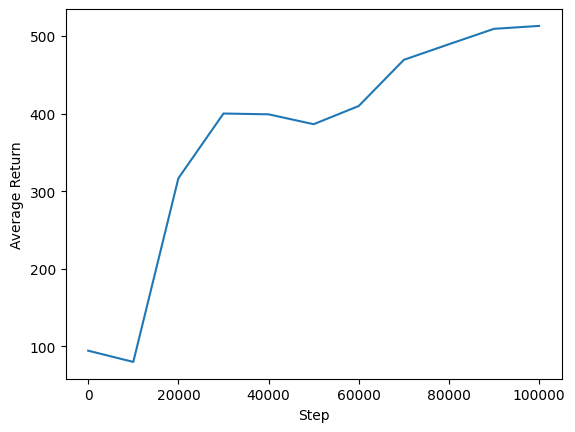

In [15]:
#Visualisation
steps = range(0, num_iterations + 1, eval_interval)
plt.plot(steps, returns)
plt.ylabel('Average Return')
plt.xlabel('Step')
plt.ylim()

In [16]:
#Video
def embed_mp4(filename):
    """Embeds an mp4 file in the notebook."""
    video = open(filename,'rb').read()
    b64 = base64.b64encode(video)
    tag = '''
    <video width="640" height="480" controls>
    <source src="data:video/mp4;base64,{0}" type="video/mp4">
    Your browser does not support the video tag.
    </video>'''.format(b64.decode())

    return IPython.display.HTML(tag)

In [17]:
num_episodes = num_iterations
video_filename = 'humanoid.mp4'
with imageio.get_writer(video_filename, fps=60) as video:
    for i in range(num_episodes):
        time_step = eval_env.reset()
        if i % 1000 == 0:
            video.append_data(eval_env.render())
            while not time_step.is_last():
                action_step = eval_actor.policy.action(time_step)
                time_step = eval_env.step(action_step.action)
                video.append_data(eval_env.render())

embed_mp4(video_filename)

[swscaler @ 0x56ff940] Warning: data is not aligned! This can lead to a speed loss
